In [7]:
import copy

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import lime
import lime.lime_tabular
import support_functions as sf

import shap

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
from sklearn.dummy import DummyClassifier
from sklearn.svm import SVC
from sklearn.neighbors import NearestNeighbors

from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn import tree
from tqdm.notebook import tqdm  # imported this just to avoid warning message

# sharp plots with higher resolution
%config InlineBackend.figure_format = 'svg'
plt.rcParams['figure.dpi'] = 150
plt.rcParams['savefig.dpi'] = 150

In [8]:
def gaussian_generator(center, eig_val, eig_vec, size):
    sigma = np.matmul(np.matmul(eig_vec, eig_val), np.transpose(eig_vec))
    data_set = np.random.multivariate_normal(center, sigma, size)

    return data_set

In [9]:
# alternative data set 
n_1 = 1000  # number of the elements
mu_1 = np.array([0, 0])  # center (centroid)

# sigma is expected to be positive  semi-definite matrix
w_1 = np.array([[1.5, 0], [0, 4.5]])  # eigenvalues
v_1 = np.array([[0.4, 0], [0, 0.4]])  # eigenvectors

set_1 = gaussian_generator(mu_1,w_1, v_1, n_1)

set_1_1 = set_1[set_1[:, 0] > 0.5, :]
set_1_2 = set_1[set_1[:, 0] < 0.5, :]

set_1_3 = set_1_1[set_1_1[:, 1] < -0.5, :]
set_1_1 = set_1_1[set_1_1[:, 1] > -0.5, :]
set_1_4 = set_1_2[set_1_2[:, 1] < -0.5, :]
set_1_2= set_1_2[set_1_2[:, 1] > -0.5, :]

set_2_1 = set_1_1
set_2_2 = set_1_2
set_2_3 = set_1_3
set_2_4 = set_1_4

set_2_1 = set_2_1
set_2_2[:, 0] = set_2_2[:, 0] - 0.1
set_2_2[:, 1] = set_2_2[:, 1] + 0.1
set_2_4 = set_2_4
set_2_3[:, 0] = set_2_3[:, 0]
set_2_3[:, 1] = set_2_3[:, 1]

class_9 = set_2_2
class_10 = np.vstack([set_2_1, set_2_3, set_2_4])

labels_9 = np.zeros((len(class_9), 1))
labels_10 = np.ones((len(class_10), 1))

class_9 = np.hstack([class_9, labels_9])
class_10 = np.hstack([class_10, labels_10])

data_set_norm_hm_sq = np.vstack([class_9, class_10])
np.random.shuffle(data_set_norm_hm_sq)

data_set_norm_hm_sq = data_set_norm_hm_sq[data_set_norm_hm_sq[:, 0] < 2, :]
data_set_norm_hm_sq = data_set_norm_hm_sq[data_set_norm_hm_sq[:, 0] > -2, :]

data_set_norm_hm_sq = data_set_norm_hm_sq[data_set_norm_hm_sq[:, 1] < 2, :]


In [10]:
set_2_1 = set_1_1
set_2_2 = set_1_2
set_2_3 = set_1_3
set_2_4 = set_1_4

set_2_1 = set_2_1
set_2_2[:, 0] = set_2_2[:, 0] + 0.3
set_2_2[:, 1] = set_2_2[:, 1] - 0.3
set_2_4 = set_2_4
set_2_3[:, 0] = set_2_3[:, 0]
set_2_3[:, 1] = set_2_3[:, 1]

class_9 = set_2_2
class_10 = np.vstack([set_2_1, set_2_3, set_2_4])

labels_9 = np.zeros((len(class_9), 1))
labels_10 = np.ones((len(class_10), 1))

class_9 = np.hstack([class_9, labels_9])
class_10 = np.hstack([class_10, labels_10])

data_set_norm_sm_sq = np.vstack([class_9, class_10])
np.random.shuffle(data_set_norm_sm_sq)

data_set_norm_sm_sq = data_set_norm_sm_sq[data_set_norm_sm_sq[:, 0] < 2, :]
data_set_norm_sm_sq = data_set_norm_sm_sq[data_set_norm_sm_sq[:, 0] > -2, :]

data_set_norm_sm_sq = data_set_norm_sm_sq[data_set_norm_sm_sq[:, 1] < 2, :]
data_set_norm_sm_sq = data_set_norm_sm_sq[data_set_norm_sm_sq[:, 1] > -2, :]

data_set_norm_sm_sq[:, 0:2] = data_set_norm_sm_sq[:, 0:2] * 0.5
data_set_norm_sm_sq[:, 0] = data_set_norm_sm_sq[:, 0]# + 0.5
data_set_norm_sm_sq[:, 1] = data_set_norm_sm_sq[:, 1]# + 0.5

In [11]:
data_set = data_set_norm_sm_sq

rotation_angle = np.pi / 4
rotation_matrix = np.array([[np.cos(rotation_angle), -np.sin(rotation_angle)], [np.sin(rotation_angle), np.cos(rotation_angle)]])

data_set_rot = data_set.copy()
coord_data = np.transpose(data_set[:, 0:2])
data_set_rot[:, 0:2] = np.transpose(np.matmul(rotation_matrix, coord_data))


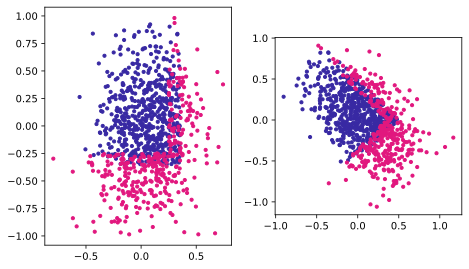

In [12]:
data_set_0 = data_set[data_set[:, -1] == 0]
data_set_1 = data_set[data_set[:, -1] == 1]

data_set_rot_0 = data_set_rot[data_set_rot[:, -1] == 0]
data_set_rot_1 = data_set_rot[data_set_rot[:, -1] == 1]



fig_1, (ax_11, ax_12) = plt.subplots(1,2, layout='constrained')
ax_11.scatter(data_set_0[:, 0], data_set_0[:, 1], color= '#3829a3', s=10)
ax_11.scatter(data_set_1[:, 0], data_set_1[:, 1], color= '#e1177e', s=10)
ax_11.set_aspect('equal')

ax_12.scatter(data_set_rot_0[:, 0], data_set_rot_0[:, 1], color= '#3829a3', s=10)
ax_12.scatter(data_set_rot_1[:, 0], data_set_rot_1[:, 1], color= '#e1177e', s=10)

ax_12.set_aspect('equal')

plt.show()

In [15]:
X = data_set[:, 0:2].copy()
y = data_set[:, 2].copy()

X_rot = data_set_rot[:, 0:2].copy()
y_rot = data_set_rot[:, 2].copy()

In [16]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, test_size=0.3, train_size=0.7)
X_rot_train, X_rot_test, y_rot_train, y_rot_test = train_test_split(X_rot, y_rot, random_state=1, test_size=0.3, train_size=0.7)

In [17]:
clf_svc = SVC(kernel='rbf', probability=True)
clf_tree = tree.DecisionTreeClassifier()
clf_KNN = KNeighborsClassifier()
clf_GNB = GaussianNB()

clf_svc_rot = SVC(kernel='rbf', probability=True)
clf_tree_rot = tree.DecisionTreeClassifier()
clf_KNN_rot = KNeighborsClassifier()
clf_GNB_rot = GaussianNB()

In [10]:
clf_svc.fit(X_train, y_train)
clf_tree.fit(X_train, y_train)
clf_KNN.fit(X_train, y_train)
clf_GNB.fit(X_train, y_train)

clf_svc_rot.fit(X_rot_train, y_rot_train)
clf_tree_rot.fit(X_rot_train, y_rot_train)
clf_KNN_rot.fit(X_rot_train, y_rot_train)
clf_GNB_rot.fit(X_rot_train, y_rot_train)

GaussianNB()

In [11]:
print('Original data, SVC accuracy: ', accuracy_score(y_test, clf_svc.predict(X_test)))
print('Original data, SVC precision: ', precision_score(y_test, clf_svc.predict(X_test))) 
print('Original data, SVC recall: ', recall_score(y_test, clf_svc.predict(X_test))) 
print('Original data, SVC f1: ', f1_score(y_test, clf_svc.predict(X_test))) 

print('Original data, DT accuracy: ', accuracy_score(y_test, clf_tree.predict(X_test)))
print('Original data, DT precision: ', precision_score(y_test, clf_tree.predict(X_test))) 
print('Original data, DT recall: ', recall_score(y_test, clf_tree.predict(X_test))) 
print('Original data, DT f1: ', f1_score(y_test, clf_tree.predict(X_test))) 

print('Original data, KNN accuracy: ', accuracy_score(y_test, clf_KNN.predict(X_test)))
print('Original data, KNN precision: ', precision_score(y_test, clf_KNN.predict(X_test))) 
print('Original data, KNN recall: ', recall_score(y_test, clf_KNN.predict(X_test))) 
print('Original data, KNN f1: ', f1_score(y_test, clf_KNN.predict(X_test))) 

print('Original data, GNB accuracy: ', accuracy_score(y_test, clf_GNB.predict(X_test)))
print('Original data, GNB precision: ', precision_score(y_test, clf_GNB.predict(X_test))) 
print('Original data, GNB recall: ', recall_score(y_test, clf_GNB.predict(X_test))) 
print('Original data, GNB f1: ', f1_score(y_test, clf_GNB.predict(X_test))) 

Original data, SVC accuracy:  0.8288590604026845
Original data, SVC precision:  0.8285714285714286
Original data, SVC recall:  0.725
Original data, SVC f1:  0.7733333333333333
Original data, DT accuracy:  0.825503355704698
Original data, DT precision:  0.788135593220339
Original data, DT recall:  0.775
Original data, DT f1:  0.7815126050420169
Original data, KNN accuracy:  0.8322147651006712
Original data, KNN precision:  0.782258064516129
Original data, KNN recall:  0.8083333333333333
Original data, KNN f1:  0.7950819672131147
Original data, GNB accuracy:  0.7885906040268457
Original data, GNB precision:  0.8131868131868132
Original data, GNB recall:  0.6166666666666667
Original data, GNB f1:  0.7014218009478673


In [12]:
print('Rotated data, SVC accuracy: ', accuracy_score(y_rot_test, clf_svc_rot.predict(X_rot_test)))
print('Rotated data, SVC precision: ', precision_score(y_rot_test, clf_svc_rot.predict(X_rot_test))) 
print('Rotated data, SVC recall: ', recall_score(y_rot_test, clf_svc_rot.predict(X_rot_test))) 
print('Rotated data, SVC f1: ', f1_score(y_rot_test, clf_svc.predict(X_rot_test))) 

print('Rotated data, DT accuracy: ', accuracy_score(y_rot_test, clf_tree_rot.predict(X_rot_test)))
print('Rotated data, DT precision: ', precision_score(y_rot_test, clf_tree_rot.predict(X_rot_test))) 
print('Rotated data, DT recall: ', recall_score(y_rot_test, clf_tree_rot.predict(X_rot_test))) 
print('Rotated data, DT f1: ', f1_score(y_rot_test, clf_tree_rot.predict(X_rot_test))) 

print('Rotated data, KNN accuracy: ', accuracy_score(y_rot_test, clf_KNN_rot.predict(X_rot_test)))
print('Rotated data, KNN precision: ', precision_score(y_rot_test, clf_KNN_rot.predict(X_rot_test))) 
print('Rotated data, KNN recall: ', recall_score(y_rot_test, clf_KNN_rot.predict(X_rot_test))) 
print('Rotated data, KNN f1: ', f1_score(y_rot_test, clf_KNN_rot.predict(X_rot_test))) 

print('Rotated data, GNB accuracy: ', accuracy_score(y_rot_test, clf_GNB_rot.predict(X_rot_test)))
print('Rotated data, GNB precision: ', precision_score(y_rot_test, clf_GNB_rot.predict(X_rot_test))) 
print('Rotated data, GNB recall: ', recall_score(y_rot_test, clf_GNB_rot.predict(X_rot_test))) 
print('Rotated data, GNB f1: ', f1_score(y_rot_test, clf_GNB_rot.predict(X_rot_test))) 

Rotated data, SVC accuracy:  0.8288590604026845
Rotated data, SVC precision:  0.8349514563106796
Rotated data, SVC recall:  0.7166666666666667
Rotated data, SVC f1:  0.625
Rotated data, DT accuracy:  0.8120805369127517
Rotated data, DT precision:  0.7807017543859649
Rotated data, DT recall:  0.7416666666666667
Rotated data, DT f1:  0.7606837606837606
Rotated data, KNN accuracy:  0.8322147651006712
Rotated data, KNN precision:  0.782258064516129
Rotated data, KNN recall:  0.8083333333333333
Rotated data, KNN f1:  0.7950819672131147
Rotated data, GNB accuracy:  0.825503355704698
Rotated data, GNB precision:  0.84
Rotated data, GNB recall:  0.7
Rotated data, GNB f1:  0.7636363636363636


In [13]:
explainer_lime = lime.lime_tabular.LimeTabularExplainer(training_data=X_train, feature_names=["feat1","feat2"],
                                                  class_names=["class1","class2"], mode='classification',
                                                discretize_continuous=False)

In [ ]:
# it works, but I am not sure if this cell is needed 

n_test = len(X_test)
exp_weights_svc = np.zeros((n_test, 2))
exp_weights_tree = np.zeros((n_test, 2))
exp_weights_KNN = np.zeros((n_test, 2))
exp_weights_GNB = np.zeros((n_test, 2))

for i in range(0, n_test):
    exp_svc = explainer_lime.explain_instance(data_row=X_test[i, :], predict_fn=clf_svc.predict_proba)
    exp_weights_svc[i, 1] = exp_svc.as_list()[0][1] # abs is not good just a temp fix
    exp_weights_svc[i, 0] = exp_svc.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_tree = explainer_lime.explain_instance(data_row=X_test[i, :], predict_fn=clf_tree.predict_proba)
    exp_weights_tree[i, 1] = exp_svc.as_list()[0][1] # abs is not good just a temp fix
    exp_weights_tree[i, 0] = exp_svc.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_KNN = explainer_lime.explain_instance(data_row=X_test[i, :], predict_fn=clf_KNN.predict_proba)
    exp_weights_KNN[i, 1] = exp_svc.as_list()[0][1] # abs is not good just a temp fix
    exp_weights_KNN[i, 0] = exp_svc.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_GNB = explainer_lime.explain_instance(data_row=X_test[i, :], predict_fn=clf_GNB.predict_proba)
    exp_weights_GNB[i, 1] = exp_svc.as_list()[0][1] # abs is not good just a temp fix
    exp_weights_GNB[i, 0] = exp_svc.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    

In [ ]:
# for testing purposes only
def classify_and_explain(X_train, X_test, y_train, y_test, flat_grid, classifier, explainer, data_name, print_metrics):
    classifier.fit(X_train, y_train)
    y_hat = classifier.predict(X_test)
    classifier_name = type(classifier)

    if print_metrics:
        print(data_name, ' ', classifier_name, ' accuracy score: ', accuracy_score(y_test, y_hat))
        print(data_name, ' ', classifier_name, ' precision score: ', precision_score(y_test, y_hat))
        print(data_name, ' ', classifier_name, ' recall score: ', recall_score(y_test, y_hat))
        print(data_name, ' ', classifier_name, ' f1 score: ', f1_score(y_test, y_hat))

    hat_grid = classifier.predict(flat_grid)

    explainer_type_internal = type(explainer).__name__
    print('Using: ', explainer)
    exp_grid_weights = []
    if explainer_type_internal == 'LimeTabularExplainer':
        print('lime')
        x = flat_grid[:, 0]
        n_grid = len(flat_grid)
        exp_grid_weights = np.zeros((n_grid, 2))

        for i in range(0, n_grid):
            exp_svc_rot = explainer.explain_instance(data_row=flat_grid[i, :], predict_fn=classifier.predict_proba)
            exp_grid_weights[i, 1] = exp_svc_rot.as_list()[0][1]
            exp_grid_weights[i, 0] = exp_svc_rot.as_list()[1][1]  # NB!  observe the chane of indexes due to the fact
            # that second feature comes first

    elif explainer_type_internal == 'Kernel':
        explainer_shap = shap.KernelExplainer(classifier.predict_proba, X_train)
        exp_grid_weights = explainer_shap.shap_values(flat_grid)

    return y_hat, hat_grid, exp_grid_weights, explainer_type_internal

In [44]:
n_test = len(X_test)
exp_weights_svc = np.zeros((n_test, 2))
flat_grid, grid_elements  = sf.get_grid(data_set=X_test, step_size=0.04, idx_column=False)

y_hat, hat_grid, exp_grid_weights, explainer_type_internal = sf.classify_and_explain(X_train, X_test, y_train, y_test, flat_grid, clf_svc,explainer_lime, data_name='original', print_metrics=False)
print(explainer_type_internal)

Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


Using:  <shap.explainers._kernel.Kernel object at 0x000002D13F022450>


  0%|          | 0/2116 [00:00<?, ?it/s]

Kernel


In [45]:
fig_t,(ax_t1, ax_t2) = plt.subplots(1,2, layout='constrained')
ax_t1.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights[:, 0], cmap='RdBu', s=10, alpha=0.7)
#ax_t1.scatter(flat_grid[:, 0], flat_grid[:, 1], color= exp_grid_weights[:, 0], s=1)
ax_t1.set_aspect('equal')

ax_t2.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights[:, 1], cmap='RdBu', s=10, alpha=0.7)
#ax_t2.scatter(flat_grid[:, 0], flat_grid[:, 1], color= exp_grid_weights[:, 1], s=10)

ax_t2.set_aspect('equal')

plt.show()

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x000002D13BFA8E00> (for post_execute):



KeyboardInterrupt



In [63]:
flat_grid, grid_elements  = sf.get_grid(data_set=X_test, step_size=0.04, idx_column=False)
y_hat_grid_svc = (clf_svc.predict(flat_grid))
y_hat_grid_tree = (clf_tree.predict(flat_grid))
y_hat_grid_KNN = (clf_KNN.predict(flat_grid))
y_hat_grid_GNB = (clf_GNB.predict(flat_grid))

#decision_boundary = sf.get_decision_boundary(grid_elements, y_hat_grid, flat_grid)

x = flat_grid[:, 0]
y = flat_grid[:, 1]

n_grid = len(x)
exp_grid_weights_svc = np.zeros((n_grid, 2))
exp_grid_weights_tree = np.zeros((n_grid, 2))
exp_grid_weights_KNN = np.zeros((n_grid, 2))
exp_grid_weights_GNB = np.zeros((n_grid, 2))

for i in range(0, n_grid):
    exp_svc = explainer_lime.explain_instance(data_row=flat_grid[i, :], predict_fn=clf_svc.predict_proba)
    exp_grid_weights_svc[i, 1] = exp_svc.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_svc[i, 0] = exp_svc.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_tree = explainer_lime.explain_instance(data_row=flat_grid[i, :], predict_fn=clf_tree.predict_proba)
    exp_grid_weights_tree[i, 1] = exp_tree.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_tree[i, 0] = exp_tree.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_KNN = explainer_lime.explain_instance(data_row=flat_grid[i, :], predict_fn=clf_KNN.predict_proba)
    exp_grid_weights_KNN[i, 1] = exp_KNN.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_KNN[i, 0] = exp_KNN.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_GNB = explainer_lime.explain_instance(data_row=flat_grid[i, :], predict_fn=clf_GNB.predict_proba)
    exp_grid_weights_GNB[i, 1] = exp_GNB.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_GNB[i, 0] = exp_GNB.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    

In [64]:
flat_grid_rot, grid_elements_rot  = sf.get_grid(data_set=X_rot_test, step_size=0.04, idx_column=False)
y_hat_grid_svc_rot = (clf_svc_rot.predict(flat_grid_rot))
y_hat_grid_tree_rot = (clf_tree_rot.predict(flat_grid_rot))
y_hat_grid_KNN_rot = (clf_KNN_rot.predict(flat_grid_rot))
y_hat_grid_GNB_rot = (clf_GNB_rot.predict(flat_grid_rot))

#decision_boundary = sf.get_decision_boundary(grid_elements, y_hat_grid, flat_grid)

xx_rot = flat_grid_rot[:, 0]
yyy_rot = flat_grid_rot[:, 1]

n_grid_rot = len(xx_rot)
exp_grid_weights_svc_rot = np.zeros((n_grid_rot, 2))
exp_grid_weights_tree_rot = np.zeros((n_grid_rot, 2))
exp_grid_weights_KNN_rot = np.zeros((n_grid_rot, 2))
exp_grid_weights_GNB_rot = np.zeros((n_grid_rot, 2))

for i in range(0, n_grid_rot):
    exp_svc_rot = explainer_lime.explain_instance(data_row=flat_grid_rot[i, :], predict_fn=clf_svc_rot.predict_proba)
    exp_grid_weights_svc_rot[i, 1] = exp_svc_rot.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_svc_rot[i, 0] = exp_svc_rot.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_tree_rot = explainer_lime.explain_instance(data_row=flat_grid_rot[i, :], predict_fn=clf_tree_rot.predict_proba)
    exp_grid_weights_tree_rot[i, 1] = exp_tree_rot.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_tree_rot[i, 0] = exp_tree_rot.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_KNN_rot = explainer_lime.explain_instance(data_row=flat_grid_rot[i, :], predict_fn=clf_KNN_rot.predict_proba)
    exp_grid_weights_KNN_rot[i, 1] = exp_KNN_rot.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_KNN_rot[i, 0] = exp_KNN_rot.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first
    
    exp_GNB_rot = explainer_lime.explain_instance(data_row=flat_grid_rot[i, :], predict_fn=clf_GNB_rot.predict_proba)
    exp_grid_weights_GNB_rot[i, 1] = exp_GNB_rot.as_list()[0][1] # abs is not good just a temp fix
    exp_grid_weights_GNB_rot[i, 0] = exp_GNB_rot.as_list()[1][1] # NB!  observe the chane of indexes due to the fact that second feature comes first

In [66]:
plt.rcParams['figure.figsize'] = [10, 10]
fig_2, ((ax_21, ax_22, ax_23, ax_24), (ax_25, ax_26, ax_27, ax_28), (ax_29, ax_30, ax_31, ax_32), (ax_33, ax_34, ax_35, ax_36)) = plt.subplots(4,4, layout='constrained')
plt.subplot(441)
plt.title('voting of the first feature')
ax_21.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_svc[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_21.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_21.set_aspect('equal')

ax_22.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_tree[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_22.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_22.set_aspect('equal')

ax_23.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_KNN[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_23.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_23.set_aspect('equal')

ax_24.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_GNB[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_24.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_24.set_aspect('equal')

ax_25.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_svc_rot[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_25.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_25.set_aspect('equal')

ax_26.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_tree_rot[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_26.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_26.set_aspect('equal')

ax_27.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_KNN_rot[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_27.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_27.set_aspect('equal')

ax_28.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_GNB_rot[:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_28.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_28.set_aspect('equal')

plt.subplot(449)
plt.title('voting of the second feature')
ax_29.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_svc[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_29.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_29.set_aspect('equal')

ax_30.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_tree[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_30.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_30.set_aspect('equal')

ax_31.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_KNN[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_31.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_31.set_aspect('equal')

ax_32.scatter(flat_grid[:, 0], flat_grid[:, 1], c= exp_grid_weights_GNB[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_32.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_32.set_aspect('equal')

ax_33.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_svc_rot[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_33.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_33.set_aspect('equal')

ax_34.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_tree_rot[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_34.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_34.set_aspect('equal')

ax_35.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_KNN_rot[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_35.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_35.set_aspect('equal')

ax_36.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= exp_grid_weights_GNB_rot[:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_36.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_36.set_aspect('equal')


plt.show()

In [40]:
shap.initjs()

In [41]:
explainer_shap_svc = shap.KernelExplainer(clf_svc.predict_proba, X_train)
explainer_shap_tree = shap.KernelExplainer(clf_tree.predict_proba, X_train)
explainer_shap_KNN = shap.KernelExplainer(clf_KNN.predict_proba, X_train)
explainer_shap_GNB = shap.KernelExplainer(clf_GNB.predict_proba, X_train)

explainer_shap_svc_rot = shap.KernelExplainer(clf_svc_rot.predict_proba, X_train)
explainer_shap_tree_rot = shap.KernelExplainer(clf_tree_rot.predict_proba, X_train)
explainer_shap_KNN_rot = shap.KernelExplainer(clf_KNN_rot.predict_proba, X_train)
explainer_shap_GNB_rot = shap.KernelExplainer(clf_GNB_rot.predict_proba, X_train)

Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
Using 694 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
Usin

In [69]:
shap_values_svc = explainer_shap_svc.shap_values(flat_grid)
shap_values_tree = explainer_shap_tree.shap_values(flat_grid)
shap_values_KNN = explainer_shap_KNN.shap_values(flat_grid)
shap_values_GNB = explainer_shap_GNB.shap_values(flat_grid)

shap_values_svc_rot = explainer_shap_svc_rot.shap_values(flat_grid_rot)
shap_values_tree_rot = explainer_shap_tree_rot.shap_values(flat_grid_rot)
shap_values_KNN_rot = explainer_shap_KNN_rot.shap_values(flat_grid_rot)
shap_values_GNB_rot = explainer_shap_GNB_rot.shap_values(flat_grid_rot)

  0%|          | 0/2304 [00:00<?, ?it/s]

  0%|          | 0/2304 [00:00<?, ?it/s]

  0%|          | 0/2304 [00:00<?, ?it/s]

  0%|          | 0/2304 [00:00<?, ?it/s]

  0%|          | 0/2601 [00:00<?, ?it/s]

  0%|          | 0/2601 [00:00<?, ?it/s]

  0%|          | 0/2601 [00:00<?, ?it/s]

  0%|          | 0/2601 [00:00<?, ?it/s]

In [70]:
plt.rcParams['figure.figsize'] = [10, 10]
fig_4, ((ax_41, ax_42, ax_43, ax_44), (ax_45, ax_46, ax_47, ax_48), (ax_49, ax_50, ax_51, ax_52), (ax_53, ax_54, ax_55, ax_56)) = plt.subplots(4,4, layout='constrained')
plt.subplot(441)
plt.title('voting of the first feature (shap)')

ax_41.scatter(flat_grid[:, 0], flat_grid[:, 1], c= shap_values_svc[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_41.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_41.set_aspect('equal')

ax_42.scatter(flat_grid[:, 0], flat_grid[:, 1], c=  shap_values_tree[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_42.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_42.set_aspect('equal')

ax_43.scatter(flat_grid[:, 0], flat_grid[:, 1], c=  shap_values_KNN[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_43.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_43.set_aspect('equal')

ax_44.scatter(flat_grid[:, 0], flat_grid[:, 1], c=  shap_values_GNB[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_44.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_44.set_aspect('equal')

ax_45.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_svc_rot[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_45.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_45.set_aspect('equal')

ax_46.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_tree_rot[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_46.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_46.set_aspect('equal')

ax_47.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_KNN_rot[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_47.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_47.set_aspect('equal')

ax_48.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_GNB_rot[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_48.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_48.set_aspect('equal')

plt.subplot(449)
plt.title('voting of the second feature (shap)')
ax_49.scatter(flat_grid[:, 0], flat_grid[:, 1], c= shap_values_svc[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_49.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_49.set_aspect('equal')

ax_50.scatter(flat_grid[:, 0], flat_grid[:, 1], c= shap_values_tree[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_50.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_50.set_aspect('equal')

ax_51.scatter(flat_grid[:, 0], flat_grid[:, 1], c= shap_values_KNN[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_51.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_51.set_aspect('equal')

ax_52.scatter(flat_grid[:, 0], flat_grid[:, 1], c= shap_values_GNB[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_52.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_52.set_aspect('equal')

ax_53.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_svc_rot[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_53.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_53.set_aspect('equal')

ax_54.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_tree_rot[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_54.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_54.set_aspect('equal')

ax_55.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_KNN_rot[0][:, 1], cmap='RdBu', s=10, alpha=0.7)
ax_55.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_55.set_aspect('equal')

ax_56.scatter(flat_grid_rot[:, 0], flat_grid_rot[:, 1], c= shap_values_GNB_rot[0][:, 0], cmap='RdBu', s=10, alpha=0.7)
ax_56.scatter(X_rot_train[:, 0], X_rot_train[:, 1], c=y_train, cmap='bwr', s=1)
ax_56.set_aspect('equal')


plt.show()